<a href="https://colab.research.google.com/github/Harish8444rgit/API-DATA-FETCH-APPLICATION/blob/main/cluster.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from sklearn.cluster import KMeans
import pandas as pd
import numpy as np
import seaborn as sns; sns.set()
from sklearn.preprocessing import MinMaxScaler
from matplotlib import pyplot as plt
%matplotlib inline
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
df=pd.read_csv("/content/drive/MyDrive/project_sem_6/2. PROJECT DATASETS/earthquake_dataset.csv")
df.tail()

,time,latitude,longitude,depth,magnitude,magnitude type,location
9995,2021-02-26 14:58:23 IST,36.97,72.31,10,4.5,MW,"156km E of Fayzabad, Afghanistan"
9996,2021-02-26 15:03:16 IST,22.83,93.89,125,3.2,MW,"90km SE of Champhai, Mizoram, India"
9997,2021-02-27 08:05:13 IST,36.72,71.89,231,3.8,MW,"126km ESE of Fayzabad, Afghanistan"
9998,2021-02-28 01:33:43 IST,29.32,86.70,10,3.5,ML,"223km NE of Kathmandu, Nepal"
9999,2021-02-28 18:03:20 IST,27.28,86.97,100,3.9,MW,"124km W of Yuksom, Sikkim, India"


In [3]:
# df['magnitude']=df['magnitude'].str.replace('MW','').str.replace('MB','').str.replace('MC','').str.replace('ML','').str.replace('MS','').str.replace('Mb','').str.replace('[','').str.replace(']','');

In [4]:
df['magnitude'] = df['magnitude'].astype(float)
df.dtypes

time               object
latitude          float64
longitude         float64
depth               int64
magnitude         float64
magnitude type     object
location           object
dtype: object

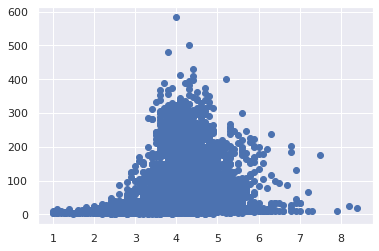

In [5]:
plt.scatter(df['magnitude'],df['depth']);

In [6]:
k_rng= range(1,100)
sse=[]
for k in k_rng:
  km=KMeans(n_clusters=k)
  km.fit(df[['depth','magnitude']])
  sse.append(km.inertia_)



In [7]:
sse

[45465271.31078436,
 10440649.683140034,
 4403467.949785268,
 2769460.5313640125,
 1776213.752667163,
 1190073.1624537962,
 877727.785956356,
 710191.6588165751,
 552083.3007860103,
 444068.6605223103,
 383256.71204022184,
 330451.2030975866,
 285336.8662101451,
 241654.6919220797,
 199167.63692295132,
 174515.84502767026,
 153214.93727882695,
 141021.5066463811,
 128985.18852373064,
 118138.98158805893,
 106901.31827169503,
 96209.60835854357,
 87332.39241002873,
 81402.32938120086,
 73448.66576206392,
 70365.47794152526,
 63060.59182452176,
 58421.29719164953,
 53627.882051408225,
 50809.67996794715,
 46444.29178980339,
 43331.734363211785,
 41573.293336283896,
 39275.9829082481,
 36912.50028133013,
 35526.318092793095,
 33911.57580396067,
 31286.106212114675,
 30258.956068677202,
 29212.992879247315,
 27171.669735387877,
 25583.054214565454,
 25131.47792887284,
 24026.032186745044,
 23058.900325471077,
 22272.659298751576,
 21179.856586460537,
 20488.863482365738,
 19832.60799642914

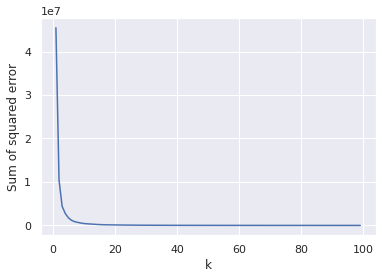

In [8]:
plt.xlabel('k')
plt.ylabel('Sum of squared error')
plt.plot(k_rng,sse)

In [10]:
km = KMeans(n_clusters=4)
y_predicate=km.fit_predict(df[['magnitude','depth']])
y_predicate

array([0, 0, 0, ..., 1, 0, 2], dtype=int32)

In [9]:
km = KMeans(n_clusters=4)
y_predicate=km.fit_predict(df[['magnitude','depth']])
y_predicate

array([0, 0, 0, ..., 1, 0, 2], dtype=int32)

In [11]:
km.cluster_centers_

array([[  3.93495914,  17.87975094],
       [  4.34155019, 186.36594663],
       [  4.31825063,  96.38519765],
       [  4.20507937, 286.11111111]])

In [12]:
df['cluster']=y_predicate
df

,time,latitude,longitude,depth,magnitude,magnitude type,location,cluster
0,2009-03-10 01:15:27 IST,30.10,83.54,33,3.1,ML,"316km NNW of Kathmandu, Nepal",0
1,2009-03-10 04:58:45 IST,35.12,73.75,10,2.9,ML,"132km NNW of Gulmarg, Jammu and Kashmir, India",0
2,2009-03-10 23:13:17 IST,23.40,69.50,10,3.1,ML,"139km NNE of Dwarka, Gujarat, India",0
3,2009-03-11 08:19:48 IST,33.35,76.50,10,2.9,ML,"115km SSW of Alchi(Leh),Jammu & Kashmir,India",0
4,2009-03-11 18:28:43 IST,10.93,91.89,10,5.1,MB,"119km SW of Portblair, Andaman and Nicobar isl...",0
...,...,...,...,...,...,...,...,...
9995,2021-02-26 14:58:23 IST,36.97,72.31,10,4.5,MW,"156km E of Fayzabad, Afghanistan",0
9996,2021-02-26 15:03:16 IST,22.83,93.89,125,3.2,MW,"90km SE of Champhai, Mizoram, India",2
9997,2021-02-27 08:05:13 IST,36.72,71.89,231,3.8,MW,"126km ESE of Fayzabad, Afghanistan",1
9998,2021-02-28 01:33:43 IST,29.32,86.70,10,3.5,ML,"223km NE of Kathmandu, Nepal",0


In [13]:
km.cluster_centers_

array([[  3.93495914,  17.87975094],
       [  4.34155019, 186.36594663],
       [  4.31825063,  96.38519765],
       [  4.20507937, 286.11111111]])

<function matplotlib.pyplot.legend(*args, **kwargs)>

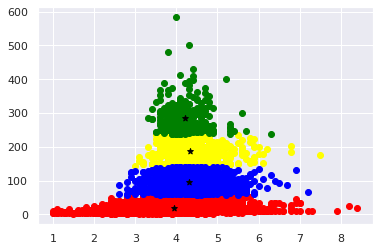

In [16]:
df1=df[df.cluster==0]
df2=df[df.cluster==1]
df3=df[df.cluster==2]
df4=df[df.cluster==3]
plt.scatter(df1.magnitude,df1['depth'],color='red')
plt.scatter(df2.magnitude,df2['depth'],color='yellow')
plt.scatter(df3.magnitude,df3['depth'],color='blue')
plt.scatter(df4.magnitude,df4['depth'],color='green')
plt.scatter(km.cluster_centers_[:,0],km.cluster_centers_[:,1],color="black",marker="*",label='c')
plt.legend

In [14]:
df

,time,latitude,longitude,depth,magnitude,magnitude type,location,cluster
0,2009-03-10 01:15:27 IST,30.10,83.54,33,3.1,ML,"316km NNW of Kathmandu, Nepal",0
1,2009-03-10 04:58:45 IST,35.12,73.75,10,2.9,ML,"132km NNW of Gulmarg, Jammu and Kashmir, India",0
2,2009-03-10 23:13:17 IST,23.40,69.50,10,3.1,ML,"139km NNE of Dwarka, Gujarat, India",0
3,2009-03-11 08:19:48 IST,33.35,76.50,10,2.9,ML,"115km SSW of Alchi(Leh),Jammu & Kashmir,India",0
4,2009-03-11 18:28:43 IST,10.93,91.89,10,5.1,MB,"119km SW of Portblair, Andaman and Nicobar isl...",0
...,...,...,...,...,...,...,...,...
9995,2021-02-26 14:58:23 IST,36.97,72.31,10,4.5,MW,"156km E of Fayzabad, Afghanistan",0
9996,2021-02-26 15:03:16 IST,22.83,93.89,125,3.2,MW,"90km SE of Champhai, Mizoram, India",2
9997,2021-02-27 08:05:13 IST,36.72,71.89,231,3.8,MW,"126km ESE of Fayzabad, Afghanistan",1
9998,2021-02-28 01:33:43 IST,29.32,86.70,10,3.5,ML,"223km NE of Kathmandu, Nepal",0


In [17]:
a_list=df[["magnitude",'latitude','longitude','time','cluster','location','depth']].values.tolist()

In [18]:
a_list


[[3.1,
  30.1,
  83.54,
  '2009-03-10 01:15:27 IST',
  0,
  '316km NNW of Kathmandu, Nepal',
  33],
 [2.9,
  35.12,
  73.75,
  '2009-03-10 04:58:45 IST',
  0,
  '132km NNW of Gulmarg, Jammu and Kashmir, India',
  10],
 [3.1,
  23.4,
  69.5,
  '2009-03-10 23:13:17 IST',
  0,
  '139km NNE of Dwarka, Gujarat, India',
  10],
 [2.9,
  33.35,
  76.5,
  '2009-03-11 08:19:48 IST',
  0,
  '115km SSW of Alchi(Leh),Jammu & Kashmir,India',
  10],
 [5.1,
  10.93,
  91.89,
  '2009-03-11 18:28:43 IST',
  0,
  '119km SW of Portblair, Andaman and Nicobar island, India',
  10],
 [2.5,
  17.29,
  73.56,
  '2009-03-11 22:08:44 IST',
  0,
  '97km NW of Kolhapur, Maharashtra, India',
  10],
 [3.6,
  32.49,
  76.36,
  '2009-03-12 21:51:36 IST',
  0,
  '30km N of Dharamshala, Himachal Pradesh, India',
  10],
 [3.4,
  36.85,
  76.63,
  '2009-03-13 06:04:18 IST',
  0,
  '259km N of Kargil, Laddakh, India',
  10],
 [3.8,
  36.2,
  69.4,
  '2009-03-13 16:49:56 IST',
  0,
  '143km SW of Fayzabad, Afghanistan',
  1

In [19]:
from geopy.geocoders import ArcGIS

In [20]:
import folium
ert_quk_map=folium.Map(location=[28.83, 77.8])
ert_quk_map.add_child(folium.Marker(location=[34.94, 72.54],popup='',icon=folium.Icon(color='green')))


In [21]:
from folium.vector_layers import Popup

import folium
ert_quk_map=folium.Map(location=[28.83, 77.8])
fg=folium.FeatureGroup(nmae='ert_quk')

for i in a_list:
  if i[4]==0:
    fg.add_child(folium.CircleMarker(location=[i[1],i[2]],popup=i[5] ,radius=1,color='yellow',fill=True))
  if i[4]==1:
    fg.add_child(folium.CircleMarker(location=[i[1],i[2]],popup=i[5] ,radius=1,color='orange',fill=True))
  if i[4]==2:
    fg.add_child(folium.CircleMarker(location=[i[1],i[2]],popup=i[5] ,radius=1,color='red',fill=True))
  if i[4]==3:
    fg.add_child(folium.CircleMarker(location=[i[1],i[2]],popup=i[5] ,radius=1,color='brown',fill=True))
    
ert_quk_map.add_child(fg)

In [22]:
df.head()

,time,latitude,longitude,depth,magnitude,magnitude type,location,cluster
0,2009-03-10 01:15:27 IST,30.10,83.54,33,3.1,ML,"316km NNW of Kathmandu, Nepal",0
1,2009-03-10 04:58:45 IST,35.12,73.75,10,2.9,ML,"132km NNW of Gulmarg, Jammu and Kashmir, India",0
2,2009-03-10 23:13:17 IST,23.40,69.50,10,3.1,ML,"139km NNE of Dwarka, Gujarat, India",0
3,2009-03-11 08:19:48 IST,33.35,76.50,10,2.9,ML,"115km SSW of Alchi(Leh),Jammu & Kashmir,India",0
4,2009-03-11 18:28:43 IST,10.93,91.89,10,5.1,MB,"119km SW of Portblair, Andaman and Nicobar isl...",0


In [ ]:
import pandas as pd
from sklearn.cluster import KMeans
import numpy as np

# Load the dataset into a pandas DataFrame
# df = pd.read_csv("data.csv")

# Drop the 'Date', 'Time', and 'Location' columns, which are not necessary for clustering
df= df.drop(['time','location'], axis=1)


# Convert the DataFrame into a numpy array
data = np.array(df)

# Create an instance of the KMeans model with 3 clusters
kmeans = KMeans(n_clusters=3)

# Fit the model to the data
kmeans.fit(data)

# Predict the cluster label for each data point
labels = kmeans.predict(data)

# Add the cluster labels to the DataFrame
df['Cluster'] = labels

# Print the first 5 rows of the DataFrame
print(df.head(1000))


In [24]:
df=pd.read_csv("/content/drive/MyDrive/project_sem_6/2. PROJECT DATASETS/new_dataset.csv")

In [25]:
a_list=df[["magnitude",'latitude','longitude','time','Cluster','location','depth']].values.tolist()

In [26]:
a_list

[[3.1,
  30.1,
  83.54,
  '2009-03-10 01:15:27 IST',
  0,
  '316km NNW of Kathmandu, Nepal',
  33],
 [2.9,
  35.12,
  73.75,
  '2009-03-10 04:58:45 IST',
  0,
  '132km NNW of Gulmarg, Jammu and Kashmir, India',
  10],
 [3.1,
  23.4,
  69.5,
  '2009-03-10 23:13:17 IST',
  0,
  '139km NNE of Dwarka, Gujarat, India',
  10],
 [2.9,
  33.35,
  76.5,
  '2009-03-11 08:19:48 IST',
  0,
  '115km SSW of Alchi(Leh),Jammu & Kashmir,India',
  10],
 [5.1,
  10.93,
  91.89,
  '2009-03-11 18:28:43 IST',
  0,
  '119km SW of Portblair, Andaman and Nicobar island, India',
  10],
 [2.5,
  17.29,
  73.56,
  '2009-03-11 22:08:44 IST',
  0,
  '97km NW of Kolhapur, Maharashtra, India',
  10],
 [3.6,
  32.49,
  76.36,
  '2009-03-12 21:51:36 IST',
  0,
  '30km N of Dharamshala, Himachal Pradesh, India',
  10],
 [3.4,
  36.85,
  76.63,
  '2009-03-13 06:04:18 IST',
  0,
  '259km N of Kargil, Laddakh, India',
  10],
 [3.8,
  36.2,
  69.4,
  '2009-03-13 16:49:56 IST',
  0,
  '143km SW of Fayzabad, Afghanistan',
  1

In [27]:
from geopy.geocoders import ArcGIS

In [28]:
import folium
ert_quk_map=folium.Map(location=[28.83, 77.8])
ert_quk_map.add_child(folium.Marker(location=[34.94, 72.54],popup='',icon=folium.Icon(color='green')))


In [29]:
from folium.vector_layers import Popup

import folium
ert_quk_map=folium.Map(location=[28.83, 77.8])
fg=folium.FeatureGroup(nmae='ert_quk')

for i in a_list:
  if i[4]==0:
    fg.add_child(folium.CircleMarker(location=[i[1],i[2]],popup=i[5] ,radius=1,color='yellow',fill=True))
  if i[4]==1:
    fg.add_child(folium.CircleMarker(location=[i[1],i[2]],popup=i[5] ,radius=1,color='orange',fill=True))
  if i[4]==2:
    fg.add_child(folium.CircleMarker(location=[i[1],i[2]],popup=i[5] ,radius=1,color='red',fill=True))
  if i[4]==3:
    fg.add_child(folium.CircleMarker(location=[i[1],i[2]],popup=i[5] ,radius=1,color='brown',fill=True))
    
ert_quk_map.add_child(fg)

In [ ]:
# from google.colab import files

# df.to_csv('modified_dataset.csv', index=False)

# files.download('modified_dataset.csv')


In [30]:
df_new =pd.read_csv("/content/drive/MyDrive/project_sem_6/2. PROJECT DATASETS/modified_dataset.csv")

In [31]:
df_new.head()

,depth,magnitude,Cluster
0,33,3.1,0
1,10,2.9,0
2,10,3.1,0
3,10,2.9,0
4,10,5.1,0


In [32]:
df_new =df_new.drop(["Cluster"],axis=1)

In [33]:
!pip install hdbscan

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.2/5.2 MB 65.8 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Created wheel for hdbscan: filename=hdbscan-0.8.29-cp38-cp38-linux_x86_64.whl size=3773981 sha256=fe73919ea1fa0f8d7cec57851dbdb5a3c18565af306500ae77d129651e277008
  Stored in directory: /root/.cache/pip/wheels/76/06/48/527e038689c581cc9e519c73840efdc7473805149e55bd7ffd
Successfully built hdbscan


[785 976 980 ...  60 979 593]


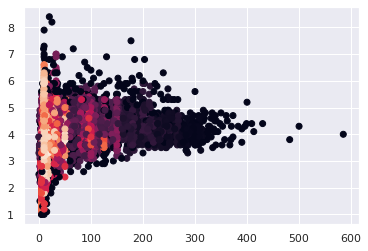

In [34]:
import hdbscan
import numpy as np
import pandas as pd

# Load the data
data = np.array(df_new)

# Fit HDBSCAN to the data
clusterer = hdbscan.HDBSCAN(min_cluster_size=2)
clusterer.fit(data)

# Get the cluster labels for each point
labels = clusterer.labels_

# Print the cluster labels
print(labels)

# Plot the data points and the cluster labels
import matplotlib.pyplot as plt
plt.scatter(data[:,0], data[:,1], c=labels)
plt.show()


Silhouette Score: 0.7972238576331192


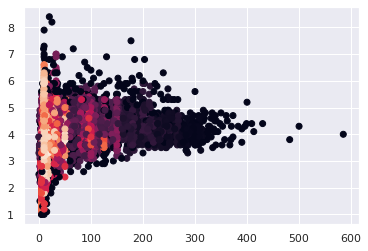

In [36]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from sklearn.metrics import silhouette_score
from hdbscan import HDBSCAN

# Load the dataset from a CSV file
data = pd.read_csv("/content/drive/MyDrive/project_sem_6/2. PROJECT DATASETS/modified_dataset.csv")

# Extract the features from the dataset
X = data.iloc[:, :-1].values

# Fit an HDBSCAN clustering model
hdbscan = HDBSCAN(min_cluster_size=2)
clusters = hdbscan.fit_predict(X)

# Calculate the Silhouette Score
silhouette_score_result = silhouette_score(X, clusters)
print("Silhouette Score:", silhouette_score_result)

# Plot the results
plt.scatter(X[:,0], X[:,1], c=clusters)
plt.show()
